## Sim Demo

### Imports

In [85]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [86]:
from env.imports import *

In [87]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

#### Check job specs

In [88]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 8.0%
RAM Usage: 16.9%
Available RAM: 312.3G
Total RAM: 376.0G
52.4G


In [89]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


None
Available GPUs: 1
GPU 0: Tesla V100-SXM2-32GB - Memory Allocated: 0.00 GB


### Data viz

In [90]:
from data.data_load import load_transcriptome, load_connectome, load_coords, load_network_labels
from data.data_viz import plot_connectome, plot_transcriptome
from data.data_utils import expand_X_symmetric, expand_Y_symmetric

In [91]:
import netneurotools
from netneurotools.datasets import fetch_schaefer2018
from netneurotools.plotting import plot_fsaverage
from netneurotools import datasets as nndata
import nibabel as nib
from netneurotools import freesurfer as nnsurf
from netneurotools import stats as nnstats
from netneurotools.plotting import plot_point_brain


In [92]:
from scipy.optimize import curve_fit
from scipy.stats import binned_statistic
from scipy.spatial import distance
from scipy.spatial.distance import cdist
from scipy import stats
from numpy.polynomial import Polynomial

In [93]:
X = load_transcriptome(parcellation='S400', hemisphere='both', omit_subcortical=False, sort_genes='chromosome', impute_strategy='mirror_interpolate')
Y = load_connectome(parcellation='S400', hemisphere='both', omit_subcortical=False)
coords = load_coords(parcellation='S400', hemisphere='both', omit_subcortical=False)
labels, network_labels = load_network_labels(parcellation='S400', hemisphere='both', omit_subcortical=False)

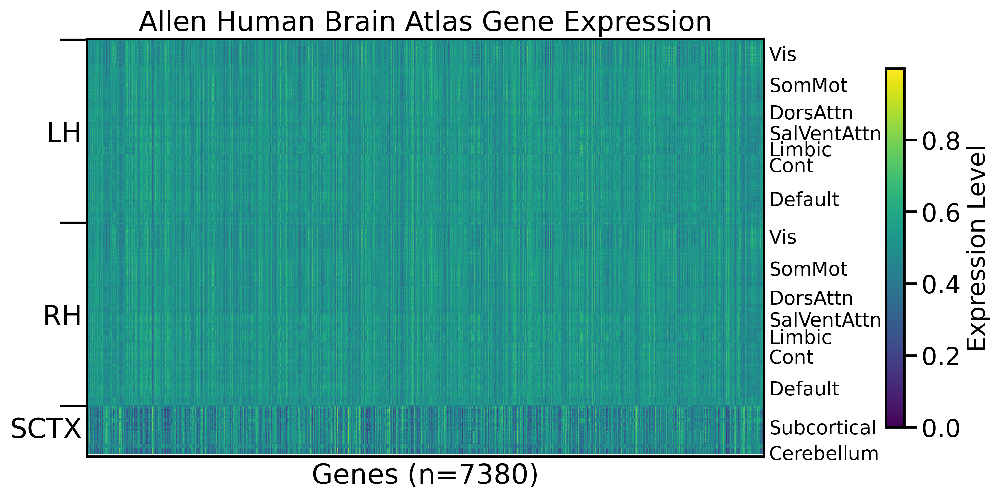

In [94]:
plot_transcriptome(null_model='none', parcellation='S400', hemisphere='both', omit_subcortical=False, gene_list='0.2', sort_genes='chromosome', impute_strategy='mirror_interpolate') #, add_hemisphere_labels=True, add_network_labels=False)

spinning gene expression


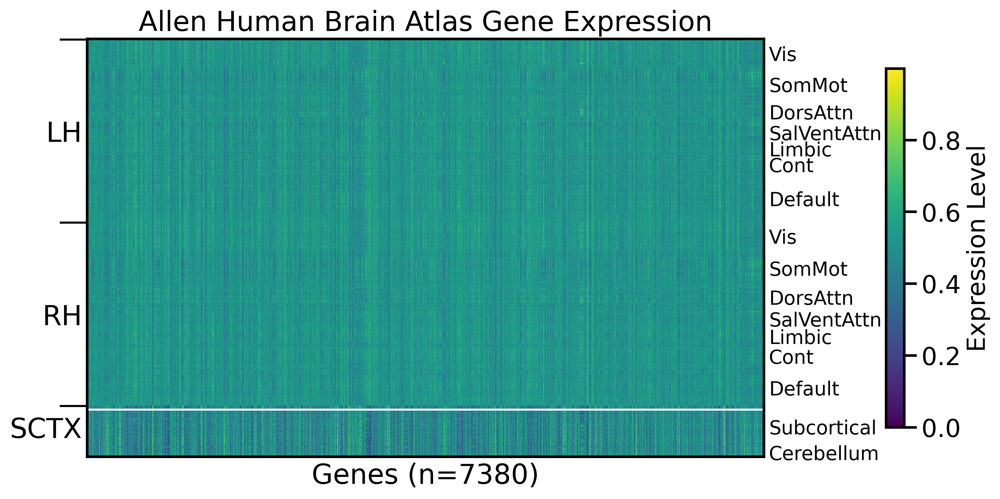

In [95]:
plot_transcriptome(null_model='spin', parcellation='S400', hemisphere='both', omit_subcortical=False, gene_list='0.2', sort_genes='chromosome', impute_strategy='mirror_interpolate') #, add_hemisphere_labels=True, add_network_labels=False)

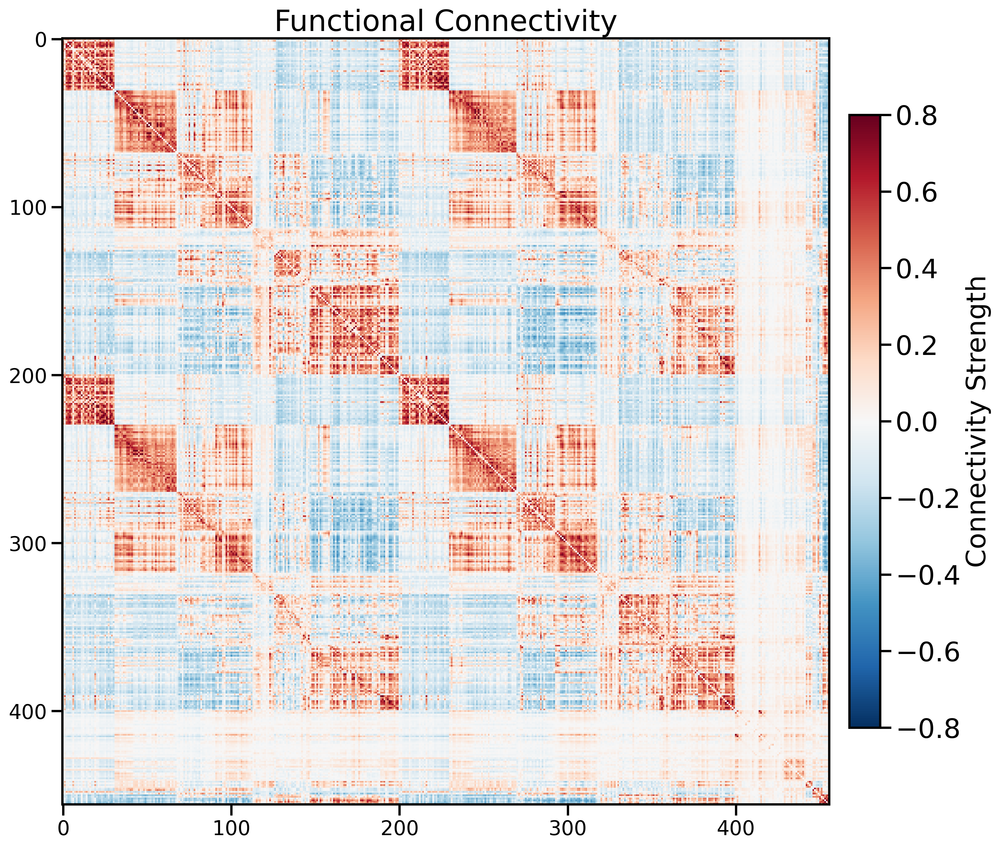

In [96]:
plot_connectome(parcellation='S400', hemisphere='both', measure='FC', omit_subcortical=False, add_network_labels=False)

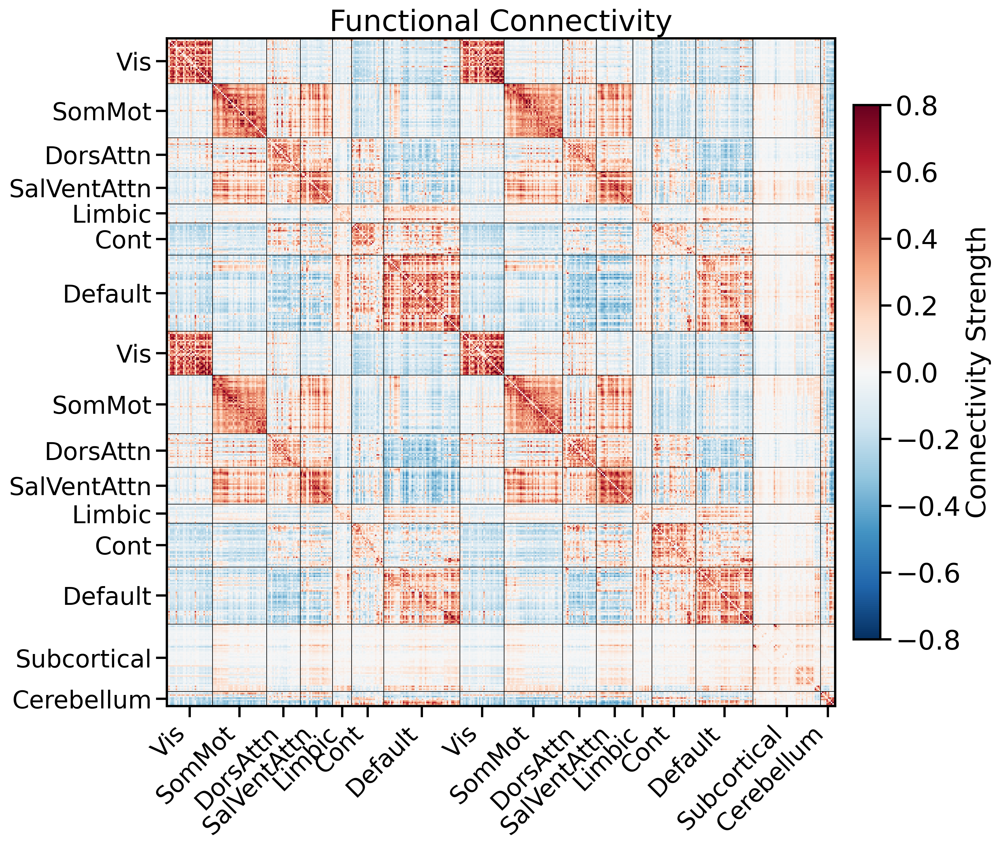

In [97]:
plot_connectome(parcellation='S400', hemisphere='both', measure='FC', omit_subcortical=False, add_network_labels=True)

### Spatial autocorr analysis

#### Overall data loading

In [98]:
def load_and_plot_data(parcellation='S400', hemisphere='both', omit_subcortical=False, 
                      sort_genes='expression', impute_strategy='mirror_interpolate', 
                      null_model='none', fontsize=16):
    # Load data
    X = load_transcriptome(parcellation=parcellation, hemisphere=hemisphere, 
                          omit_subcortical=omit_subcortical, sort_genes=sort_genes,
                          impute_strategy=impute_strategy, null_model=null_model)
    Y = load_connectome(parcellation=parcellation, hemisphere=hemisphere,
                       omit_subcortical=omit_subcortical)
    coords = load_coords(parcellation=parcellation, hemisphere=hemisphere,
                        omit_subcortical=omit_subcortical)
    labels, network_labels = load_network_labels(parcellation=parcellation,
                                               hemisphere=hemisphere,
                                               omit_subcortical=omit_subcortical)

    # Filter valid data
    valid_indices = ~np.isnan(X).all(axis=1)
    X = X[valid_indices]

    X_pca = load_transcriptome(run_PCA=True, parcellation=parcellation,
                              hemisphere=hemisphere, omit_subcortical=omit_subcortical,
                              sort_genes=sort_genes, impute_strategy=impute_strategy, null_model=null_model)
    X_pca = X_pca[valid_indices]
    Y = Y[valid_indices][:, valid_indices]

    coords = coords[valid_indices]
    labels = [labels[i] for i in range(len(labels)) if valid_indices[i]]
    network_labels = network_labels[valid_indices]

    # Compute correlation matrices
    X_corr = np.corrcoef(X, rowvar=True)
    X_pca_corr = np.corrcoef(X_pca, rowvar=True)

    # Compute distance matrix
    dist_matrix = cdist(coords, coords)

    # Create visualization
    fig, axes = plt.subplots(1, 4, figsize=(40, 8))

    # Plot X correlations
    im0 = axes[0].imshow(X_corr, cmap='RdBu_r', vmin=-1, vmax=1)
    axes[0].set_title('Gene Expression Correlations', fontsize=fontsize)
    plt.colorbar(im0, ax=axes[0])
    axes[0].tick_params(axis='both', which='major', labelsize=fontsize-2)

    # Plot X PCA correlations
    im1 = axes[1].imshow(X_pca_corr, cmap='RdBu_r', vmin=-1, vmax=1)
    axes[1].set_title('PCA Gene Expression Correlations', fontsize=fontsize)
    plt.colorbar(im1, ax=axes[1])
    axes[1].tick_params(axis='both', which='major', labelsize=fontsize-2)

    # Plot distance matrix
    im2 = axes[2].imshow(dist_matrix, cmap='viridis')
    axes[2].set_title('Euclidean Distances', fontsize=fontsize)
    plt.colorbar(im2, ax=axes[2])
    axes[2].tick_params(axis='both', which='major', labelsize=fontsize-2)

    # Plot Y matrix
    im3 = axes[3].imshow(Y, cmap='RdBu_r', vmin=-0.8, vmax=0.8)
    axes[3].set_title('Connectivity', fontsize=fontsize)
    plt.colorbar(im3, ax=axes[3])
    axes[3].tick_params(axis='both', which='major', labelsize=fontsize-2)

    plt.tight_layout()
    plt.show()

    return X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix

#### Curve fitting

In [99]:
# Define exponential decay function
def exp_decay(x, SA_inf, SA_lambda):
    """    
    Parameters
    ----------
    x : array-like
        Distance values (in mm)
    SA_inf : float
        Asymptotic value of functional connectivity at infinite distance
    SA_lambda : float
        Decay constant controlling rate of exponential decay
        
    Returns
    -------
    float or array-like
        Predicted values following exponential decay
    """
    return SA_inf + (1 - SA_inf) * np.exp(-x / SA_lambda)

def plot_distance_decay(features, y_feature='FC', bin_size_mm=5, coverage='Full Brain'):
    """Plot distance decay relationship between a feature and distance.
    
    Parameters
    ----------
    features : dict
        Dictionary containing 'distances' and feature arrays (e.g., 'FC', 'CGE', 'PCA_CGE')
    y_feature : str, optional
        Name of feature to plot on y-axis, by default 'FC'
    bin_size_mm : float, optional
        Size of distance bins in mm, by default 5
    coverage : str, optional
        Region of brain being analyzed ('Full Brain', 'Cortex', or 'Subcortex'), by default 'Full Brain'
    """
    # Create distance bins
    bin_edges = np.arange(0, max(features['distances']) + bin_size_mm, bin_size_mm)

    # Calculate binned statistics
    bin_means, bin_edges, _ = stats.binned_statistic(features['distances'], features[y_feature], 
                                             statistic='mean', bins=bin_edges)
    bin_std, _, _ = stats.binned_statistic(features['distances'], features[y_feature], 
                                   statistic='std', bins=bin_edges)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Fit exponential decay
    popt, _ = curve_fit(exp_decay, bin_centers, bin_means,
                      p0=[0, 10], bounds=([-1, 0], [1, 100]), maxfev=5000)

    # Generate fit curve
    x_fit = np.linspace(min(features['distances']), max(features['distances']), 100)
    y_fit = exp_decay(x_fit, *popt)

    # Create plot
    plt.figure(figsize=(12,8))

    # Get y-axis label based on feature
    if y_feature == 'FC':
        y_label = 'Functional Connectivity (FC)'
    elif y_feature == 'CGE':
        y_label = 'Correlated Gene Expression (CGE)'
    elif y_feature == 'PCA_CGE':
        y_label = 'PCA CGE'
    else:
        y_label = y_feature.replace('_', ' ').title()

    plt.bar(bin_centers, bin_means, width=bin_size_mm, color='#808080', alpha=0.6)
    plt.scatter(features['distances'], features[y_feature], color='gray', 
               alpha=0.1, s=0.8)
    plt.errorbar(bin_centers, bin_means, yerr=bin_std, color='black', fmt='o',
                markersize=2, capsize=1, linewidth=0.5,
                label=f"Mean {y_label} ({bin_size_mm}mm bins)")
    plt.plot(x_fit, y_fit, "r-", linewidth=2.5, label="Exp Decay Fit")
    plt.axvline(x=popt[1], color='green', linestyle='--', alpha=0.2)

    # Add SA parameters text
    sa_text = f'SA-λ = {popt[1]:.3f}\nSA-∞ = {popt[0]:.3f}'
    plt.text(0.95, 0.75, sa_text, transform=plt.gca().transAxes,
            bbox=dict(facecolor='white', alpha=0.8),
            horizontalalignment='right', verticalalignment='bottom',
            fontsize=18)

    plt.xlabel('Distance (mm)', fontsize=18)
    plt.ylabel(y_label, fontsize=18)
    plt.title(f'Distance vs {y_label} ({coverage})', fontsize=20)
    plt.tick_params(axis='both', which='major', labelsize=16)
    plt.legend(fontsize=16)

    plt.tight_layout()
    plt.show()


def plot_distance_decay_poly3(features, y_feature='FC', bin_size_mm=5, coverage='Full Brain'):
    """Plot distance decay using a 3rd order polynomial fit.

    Parameters
    ----------
    features : dict
        Dictionary containing 'distances' and feature arrays (e.g., 'FC', 'CGE', 'PCA_CGE')
    y_feature : str, optional
        Name of feature to plot on y-axis, by default 'FC'
    bin_size_mm : float, optional
        Size of distance bins in mm, by default 5
    coverage : str, optional
        Region of brain being analyzed ('Full Brain', 'Cortex', or 'Subcortex'), by default 'Full Brain'
    """
    # Create distance bins
    bin_edges = np.arange(0, max(features['distances']) + bin_size_mm, bin_size_mm)

    # Calculate binned statistics
    bin_means, bin_edges, _ = stats.binned_statistic(features['distances'], features[y_feature], 
                                                     statistic='mean', bins=bin_edges)
    bin_std, _, _ = stats.binned_statistic(features['distances'], features[y_feature], 
                                           statistic='std', bins=bin_edges)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Remove NaNs (may occur if a bin is empty)
    valid = ~np.isnan(bin_means)
    bin_centers = bin_centers[valid]
    bin_means = bin_means[valid]
    bin_std = bin_std[valid]

    # Fit a 3rd order polynomial
    poly3 = Polynomial.fit(bin_centers, bin_means, deg=3)
    coefs = poly3.convert().coef  # Convert to standard basis to extract raw coefficients

    x_fit = np.linspace(min(features['distances']), max(features['distances']), 100)
    y_fit = poly3(x_fit)

    # Create plot
    plt.figure(figsize=(12, 8))

    if y_feature == 'FC':
        y_label = 'Functional Connectivity (FC)'
    elif y_feature == 'CGE':
        y_label = 'Correlated Gene Expression (CGE)'
    elif y_feature == 'PCA_CGE':
        y_label = 'PCA CGE'
    else:
        y_label = y_feature.replace('_', ' ').title()

    plt.bar(bin_centers, bin_means, width=bin_size_mm, color='#808080', alpha=0.6)
    plt.scatter(features['distances'], features[y_feature], color='gray', alpha=0.1, s=0.8)
    plt.errorbar(bin_centers, bin_means, yerr=bin_std, color='black', fmt='o',
                 markersize=2, capsize=1, linewidth=0.5,
                 label=f"Mean {y_label} ({bin_size_mm}mm bins)")
    plt.plot(x_fit, y_fit, "darkorange", linewidth=2.5, label="3rd Order Polynomial Fit")

    # Add polynomial coefficients to plot
    coef_text = '\n'.join([
        f"$a_3$ = {coefs[3]:.4e}",
        f"$a_2$ = {coefs[2]:.4e}",
        f"$a_1$ = {coefs[1]:.4e}",
        f"$a_0$ = {coefs[0]:.4e}",
    ])
    plt.text(0.05, 0.05, coef_text, transform=plt.gca().transAxes,
             bbox=dict(facecolor='white', alpha=0.8),
             horizontalalignment='left', verticalalignment='bottom',
             fontsize=14)

    plt.xlabel('Distance (mm)', fontsize=18)
    plt.ylabel(y_label, fontsize=18)
    plt.title(f'Distance vs {y_label} ({coverage})', fontsize=20)
    plt.tick_params(axis='both', which='major', labelsize=16)
    plt.legend(fontsize=16)

    plt.tight_layout()
    plt.show()

def plot_distance_fits(features, y_feature, bin_size_mm=10, coverage='Full Brain'):
    """
    Plot distance relationships with exponential decay, polynomial and linear fits
    
    Args:
        features (dict): Dictionary containing distances and feature values
        y_feature (str): Feature to plot ('FC', 'CGE', or 'PCA_CGE')
        bin_size_mm (float): Size of distance bins in mm
        coverage (str): Brain coverage description for title
    """
    # Calculate binned statistics
    bins = np.arange(0, max(features['distances']) + bin_size_mm, bin_size_mm)
    bin_centers = bins[:-1] + bin_size_mm/2
    bin_means, _, _ = stats.binned_statistic(features['distances'], 
                                           features[y_feature], 
                                           statistic='mean', 
                                           bins=bins)
    bin_std, _, _ = stats.binned_statistic(features['distances'], 
                                          features[y_feature], 
                                          statistic='std', 
                                          bins=bins)
    valid = ~np.isnan(bin_means)
    bin_centers = bin_centers[valid]
    bin_means = bin_means[valid]
    bin_std = bin_std[valid]

    # Fit models
    # 3rd order polynomial
    poly3 = Polynomial.fit(bin_centers, bin_means, deg=3)
    poly_coefs = poly3.convert().coef
    # Exponential decay
    exp_params, _ = curve_fit(exp_decay, bin_centers, bin_means,
                           p0=[0, 10], bounds=([-1, 0], [1, 100]), maxfev=5000)
    
    # Linear fit
    linear = np.polyfit(bin_centers, bin_means, 1)
    
    # Generate fit lines
    x_fit = np.linspace(min(features['distances']), max(features['distances']), 100)
    y_poly = poly3(x_fit)
    y_exp = exp_decay(x_fit, *exp_params)
    y_linear = linear[0] * x_fit + linear[1]

    # Create plot
    fig, ax = plt.subplots(figsize=(12, 8))
    # Set y-axis label based on feature type
    if y_feature == 'FC':
        y_label = 'Functional Connectivity (FC)'
    elif y_feature == 'CGE':
        y_label = 'Correlated Gene Expression (CGE)'
    elif y_feature == 'PCA_CGE':
        y_label = 'PCA CGE'
    else:
        y_label = y_feature.replace('_', ' ').title()

    # Plot raw data and binned statistics
    plt.bar(bin_centers, bin_means, width=bin_size_mm, color='#808080', alpha=0.6)
    plt.scatter(features['distances'], features[y_feature], color='gray', alpha=0.1, s=0.8)
    plt.errorbar(bin_centers, bin_means, yerr=bin_std, color='black', fmt='o',
                 markersize=2, capsize=1, linewidth=0.5,
                 label=f"Mean {y_label} ({bin_size_mm}mm bins)")

    # Plot fits
    plt.plot(x_fit, y_poly, "darkorange", linewidth=2.5, label="3rd Order Polynomial")
    plt.plot(x_fit, y_exp, "red", linewidth=2.5, label="Exponential Decay")
    plt.plot(x_fit, y_linear, "blue", linewidth=2.5, label="Linear Fit")

    plt.xlabel('Distance (mm)', fontsize=18)
    plt.ylabel(y_label, fontsize=18)
    plt.title(f'Distance vs {y_label} ({coverage})', fontsize=20)
    plt.tick_params(axis='both', which='major', labelsize=16)
    plt.legend(fontsize=16, loc='upper right')

    # Add fit parameters text box outside plot
    param_text = (
        "Fit Parameters:\n\n"
        "Polynomial:\n"
        f"$a_3$ = {poly_coefs[3]:.2e}\n"
        f"$a_2$ = {poly_coefs[2]:.2e}\n"
        f"$a_1$ = {poly_coefs[1]:.2e}\n"
        f"$a_0$ = {poly_coefs[0]:.2e}\n\n"
        "Exponential:\n"
        f"SA-∞ = {exp_params[0]:.3f}\n"
        f"SA-λ = {exp_params[1]:.3f}\n\n"
        "Linear:\n"
        f"slope = {linear[0]:.2e}\n"
        f"intercept = {linear[1]:.2e}"
    )
    
    plt.figtext(1.02, 0.5, param_text, fontsize=14, 
                bbox=dict(facecolor='white', alpha=0.8),
                va='center')

    plt.tight_layout()
    plt.show()

#### Subsetting brain data to full brain, cortex, subcortex

In [100]:
def subset_brain_data(X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix):
    # subset all to valid indices
    valid_indices = ~np.isnan(X).all(axis=1)
    X = X[valid_indices]
    X_pca = X_pca[valid_indices]
    Y = Y[valid_indices][:, valid_indices]
    coords = coords[valid_indices]
    labels = [labels[i] for i in range(len(labels)) if valid_indices[i]]
    network_labels = network_labels[valid_indices]

    # Get upper triangular indices (excluding diagonal)
    triu_indices = np.triu_indices(X_corr.shape[0], k=1)
    X_corr_vec = X_corr[triu_indices]
    X_pca_vec = X_pca_corr[triu_indices]
    dist_vec = dist_matrix[triu_indices] 
    Y_vec = Y[triu_indices]

    # Create features dictionary with distances and fc values
    features = {
        'distances': dist_vec,
        'CGE': X_corr_vec,
        'FC': Y_vec,
        'PCA_CGE': X_pca_vec
    }
    # Separate cortical data
    n = (X.shape[0] // 100) * 100  # Hacky way to retain only cortical regions by rounding down to nearest hundred
    X_cortex = X[:n]
    X_cortex_pca = X_pca[:n] 
    Y_cortex = Y[:n, :n]
    coords_cortex = coords[:n]
    labels_cortex = labels[:n]
    network_labels_cortex = network_labels[:n]

    # Calculate cortical correlations
    X_cortex_corr = np.corrcoef(X_cortex, rowvar=True)
    X_cortex_pca_corr = np.corrcoef(X_cortex_pca, rowvar=True)

    # compute distance matrix of coords
    dist_cortex_matrix = cdist(coords_cortex, coords_cortex)

    # Get upper triangular indices for cortex (excluding diagonal)
    triu_indices_cortex = np.triu_indices(X_cortex_corr.shape[0], k=1)
    X_cortex_corr_vec = X_cortex_corr[triu_indices_cortex]
    X_cortex_pca_corr_vec = X_cortex_pca_corr[triu_indices_cortex]
    dist_vec_cortex = dist_cortex_matrix[triu_indices_cortex]
    Y_cortex_vec = Y_cortex[triu_indices_cortex]

    # Create features dictionary for cortex
    features_cortex = {
        'distances': dist_vec_cortex,
        'CGE': X_cortex_corr_vec, 
        'FC': Y_cortex_vec,
        'PCA_CGE': X_cortex_pca_corr_vec
    }
    # Separate subcortical data
    X_subcortex = X[n:]
    X_subcortex_pca = X_pca[n:]
    Y_subcortex = Y[n:, n:]
    coords_subcortex = coords[n:]
    labels_subcortex = labels[n:]
    network_labels_subcortex = network_labels[n:]

    # Calculate subcortical correlations
    X_subcortex_corr = np.corrcoef(X_subcortex, rowvar=True)
    X_subcortex_pca_corr = np.corrcoef(X_subcortex_pca, rowvar=True)

    # compute distance matrix of coords
    dist_subcortex_matrix = cdist(coords_subcortex, coords_subcortex)

    # Get upper triangular indices for subcortex (excluding diagonal)
    triu_indices_subcortex = np.triu_indices(X_subcortex_corr.shape[0], k=1)
    X_subcortex_corr_vec = X_subcortex_corr[triu_indices_subcortex]
    X_subcortex_pca_corr_vec = X_subcortex_pca_corr[triu_indices_subcortex]
    dist_vec_subcortex = dist_subcortex_matrix[triu_indices_subcortex]
    Y_subcortex_vec = Y_subcortex[triu_indices_subcortex]

    # Create features dictionary for subcortex
    features_subcortex = {
        'distances': dist_vec_subcortex,
        'CGE': X_subcortex_corr_vec, 
        'FC': Y_subcortex_vec,
        'PCA_CGE': X_subcortex_pca_corr_vec
    }
    
    return features, features_cortex, features_subcortex

Number of components for 95% variance PCA: 27


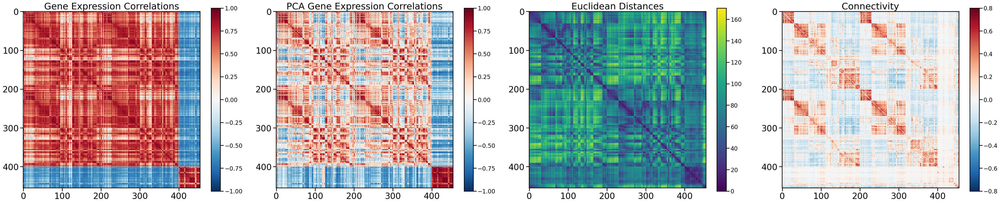

In [101]:
X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix = load_and_plot_data(parcellation='S400', hemisphere='both', omit_subcortical=False, 
                      sort_genes='expression', impute_strategy='mirror_interpolate', null_model='none', fontsize=26)

features, features_cortex, features_subcortex = subset_brain_data(X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix)

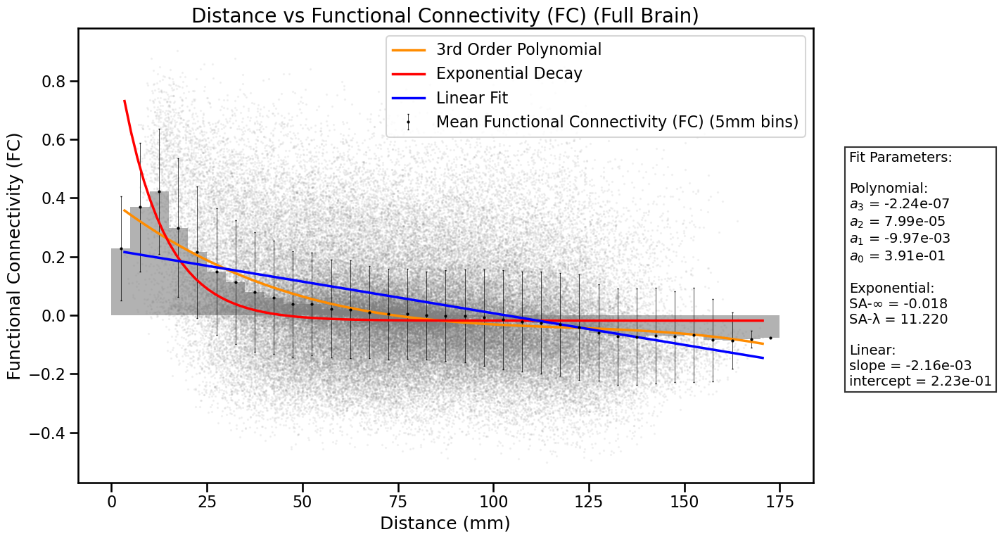

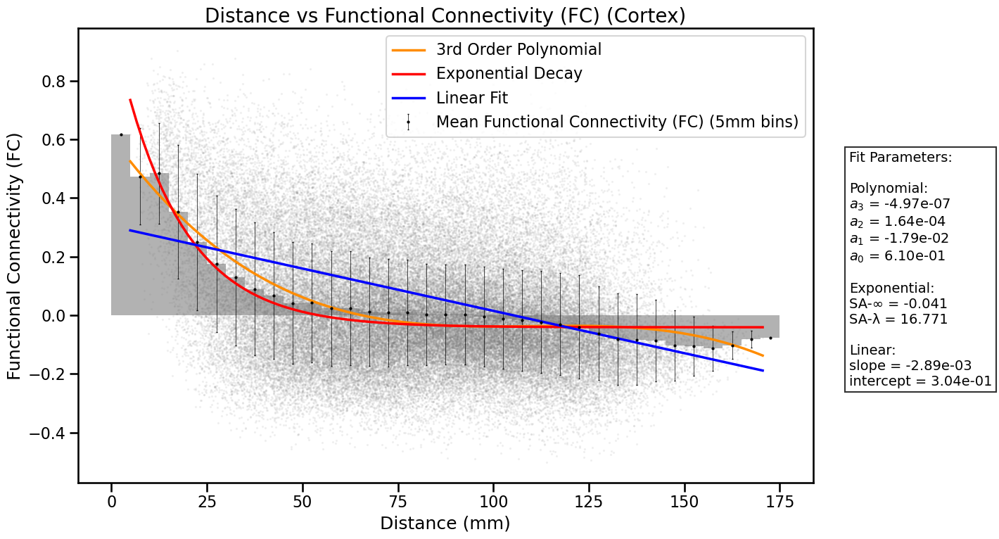

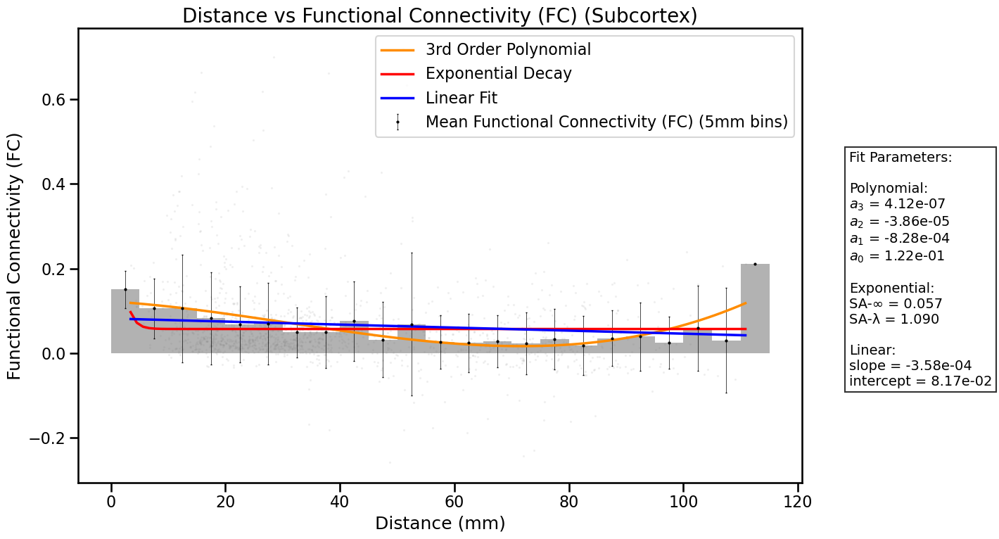

In [102]:
plot_distance_fits(features, 'FC', 5, 'Full Brain')
plot_distance_fits(features_cortex, 'FC', 5, 'Cortex')
plot_distance_fits(features_subcortex, 'FC', 5, 'Subcortex')

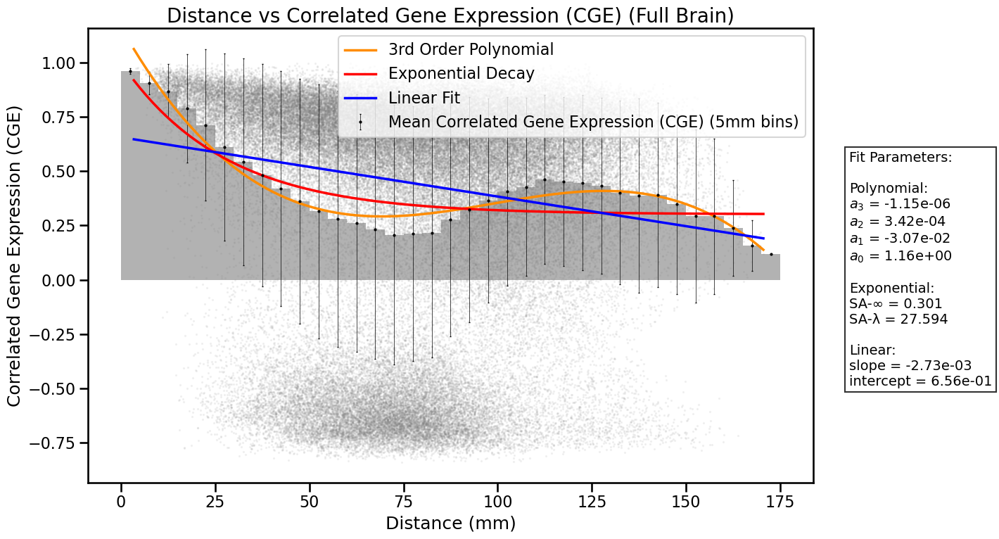

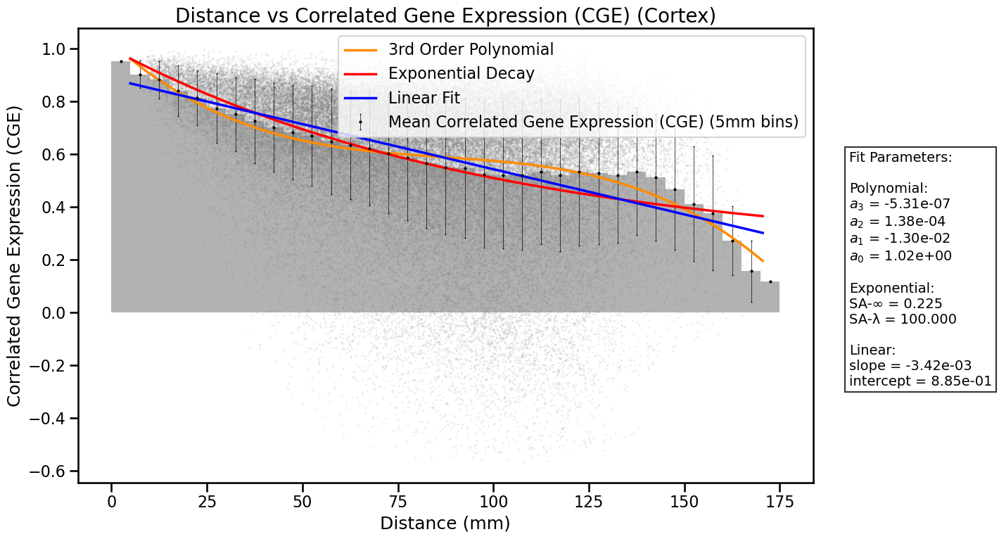

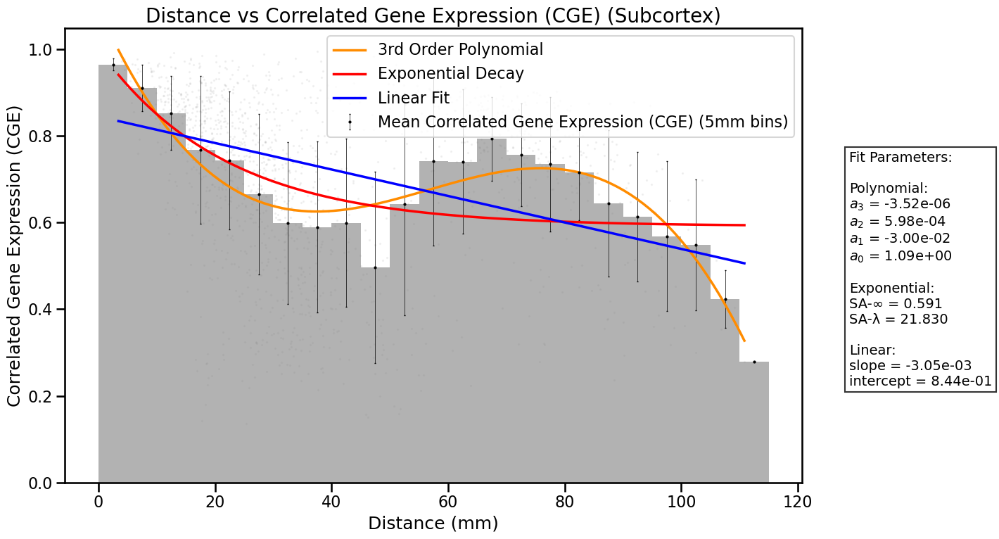

In [103]:
plot_distance_fits(features, 'CGE', 5, 'Full Brain')
plot_distance_fits(features_cortex, 'CGE', 5, 'Cortex')
plot_distance_fits(features_subcortex, 'CGE', 5, 'Subcortex')


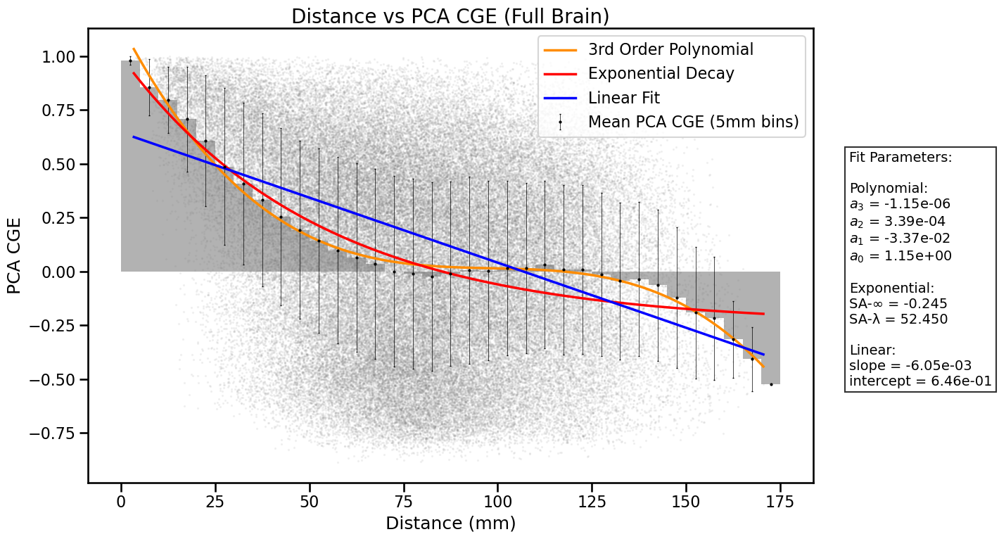

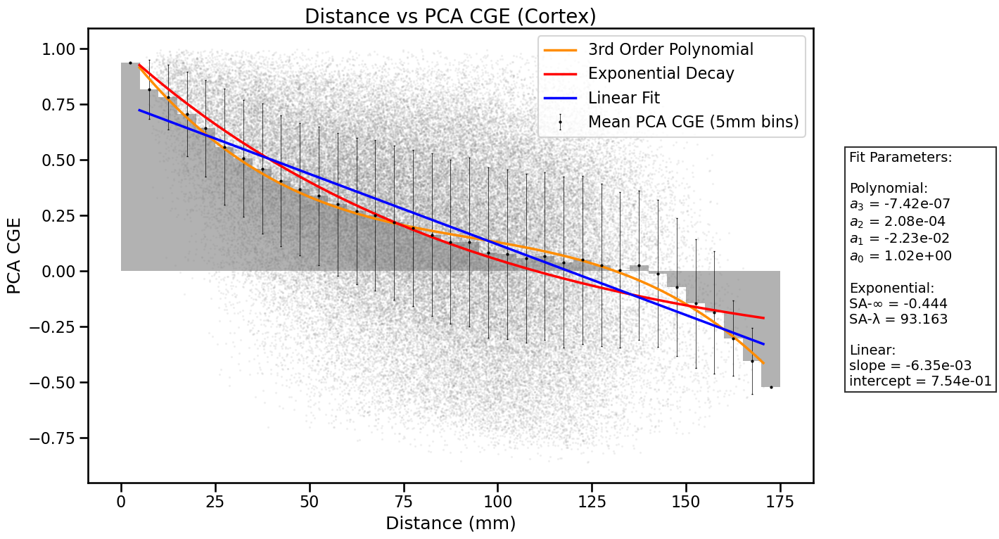

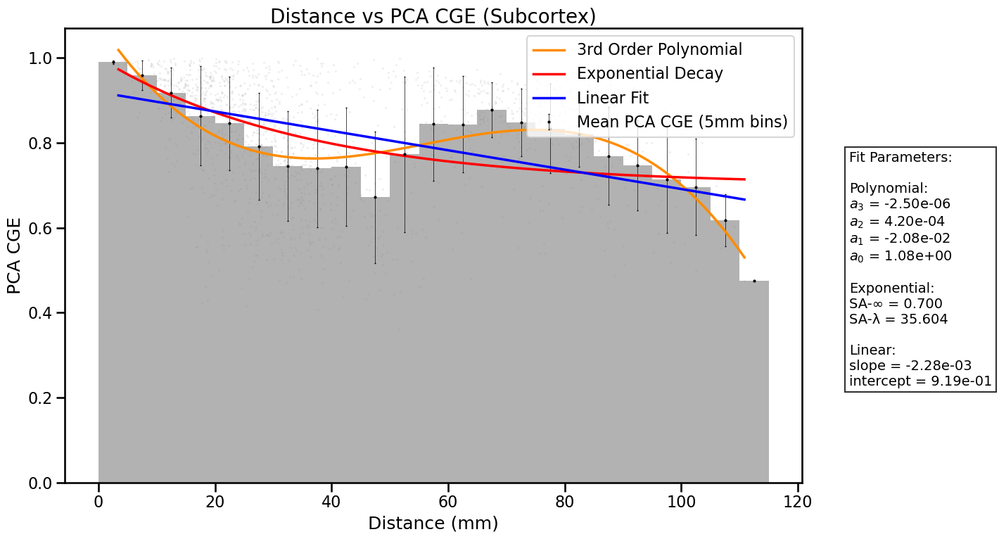

In [104]:
plot_distance_fits(features, 'PCA_CGE', 5, 'Full Brain')
plot_distance_fits(features_cortex, 'PCA_CGE', 5, 'Cortex')
plot_distance_fits(features_subcortex, 'PCA_CGE', 5, 'Subcortex')

### Create null spin tests

In [105]:
def load_features(X, coords, verbose=False):
    if verbose:
        # Start timing
        start_time = time.time()

    # Filter valid data
    valid_indices = ~np.isnan(X).all(axis=1)
    X = X[valid_indices]
    coords = coords[valid_indices]
    
    # Compute correlation matrices
    X_corr = np.corrcoef(X, rowvar=True)
    triu_indices = np.triu_indices(X_corr.shape[0], k=1)  # k=1 excludes diagonal
    X_corr_vec = X_corr[triu_indices]
    #print(X_corr_vec.shape)
    
    # Compute distance matrix
    dist_matrix = cdist(coords, coords)
    dist_vec = dist_matrix[triu_indices]
    
    if verbose:
        elapsed_time = time.time() - start_time
        print(f"Feature computation took {elapsed_time:.2f} seconds")

    return X_corr, X_corr_vec, dist_matrix, dist_vec

# Define exponential decay function
def exp_decay(x, SA_inf, SA_lambda):
    """    
    Parameters
    ----------
    x : array-like
        Distance values (in mm)
    SA_inf : float
        Asymptotic value of functional connectivity at infinite distance
    SA_lambda : float
        Decay constant controlling rate of exponential decay
        
    Returns
    -------
    float or array-like
        Predicted values following exponential decay
    """
    return SA_inf + (1 - SA_inf) * np.exp(-x / SA_lambda)

def compute_exponential_distance_decay(features, targets, bin_size_mm=5):
    # Create distance bins
    bin_edges = np.arange(0, max(features) + bin_size_mm, bin_size_mm)

    # Calculate binned statistics
    bin_means, bin_edges, _ = stats.binned_statistic(features, targets, 
                                             statistic='mean', bins=bin_edges)
    bin_std, _, _ = stats.binned_statistic(features, targets, 
                                   statistic='std', bins=bin_edges)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Fit exponential decay
    popt, _ = curve_fit(exp_decay, bin_centers, bin_means,
                      p0=[0, 10], bounds=([-1, 0], [1, 100]), maxfev=5000)

    # Get best fit parameters
    SA_inf, SA_lambda = popt

    return SA_lambda, SA_inf

def compute_distance_decay_poly3(features, targets, bin_size_mm=5):
    
    # Create distance bins
    bin_edges = np.arange(0, max(features) + bin_size_mm, bin_size_mm)

    # Calculate binned statistics
    bin_means, bin_edges, _ = stats.binned_statistic(features, targets, 
                                                     statistic='mean', bins=bin_edges)
    bin_std, _, _ = stats.binned_statistic(features, targets, 
                                           statistic='std', bins=bin_edges)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

    # Remove NaNs (may occur if a bin is empty)
    valid = ~np.isnan(bin_means)
    bin_centers = bin_centers[valid]
    bin_means = bin_means[valid]
    bin_std = bin_std[valid]

    # Fit a 3rd order polynomial
    poly3 = Polynomial.fit(bin_centers, bin_means, deg=3)
    coefs = poly3.convert().coef  # Convert to standard basis to extract raw coefficients

    return coefs


In [106]:
def generate_null_spins(n_rotations=100, seed=42, bin_size_mm=5, save_csv=False):
    """Generate null spin models and compute distance decay parameters.
    
    Args:
        n_rotations (int): Number of spin rotations to generate
        seed (int): Random seed for reproducibility 
        bin_size_mm (float): Bin size in mm for distance decay calculations
        save_csv (bool): Whether to save results to CSV
        
    Returns:
        pd.DataFrame: DataFrame containing spin indices and computed parameters
    """
    # LOAD IN TRUE GENE EXPRESSION DATA, GENE EXPRESSION PCA, TRUE COORDINATES
    genes_data, valid_genes = load_transcriptome(parcellation='S400', gene_list='0.2', run_PCA=False, omit_subcortical=False, hemisphere='both', impute_strategy='mirror_interpolate', sort_genes='expression', return_valid_genes=True, null_model='none', random_seed=42)
    genes_data_PCA = load_transcriptome(parcellation='S400', gene_list='0.2', run_PCA=True, omit_subcortical=False, hemisphere='both', impute_strategy='mirror_interpolate', sort_genes='expression', return_valid_genes=False, null_model='none', random_seed=42)
    all_region_coords = load_coords(parcellation='S400', omit_subcortical=False)

    # GENERATE SPINS FOR EACH HEMISPHERE OF CORTEX MATCHED
    lh_annot, rh_annot = nndata.fetch_schaefer2018('fsaverage', data_dir='data/UKBB', verbose=1)['400Parcels7Networks']
    coords, hemi = nnsurf.find_parcel_centroids(lhannot=lh_annot, rhannot=rh_annot, version='fsaverage', surf='sphere')
    cortical_spins, cortical_cost = nnstats.gen_spinsamples(coords, hemi, n_rotate=n_rotations, seed=seed, method='vasa',return_cost=True)

    num_cortical_regions = (genes_data.shape[0] // 100) * 100
    cortical_genes_data = genes_data[:num_cortical_regions]
    cortical_genes_data_PCA = genes_data_PCA[:num_cortical_regions]

    # GENERATE SPINS FOR EACH HEMISPHERE OF SUBCORTEX MATCHED
    subcortical_genes_data = genes_data[num_cortical_regions:]
    subcortical_genes_data_PCA = genes_data_PCA[num_cortical_regions:]
    subcortical_coords = all_region_coords[num_cortical_regions:]
    x_coords = subcortical_coords[:, 0]
    hemi_subcort = np.zeros_like(x_coords) # create mask for subcortical hemisphere
    hemi_subcort[x_coords > 0] = 1
    subcortical_spins, subcortical_cost = nnstats.gen_spinsamples(subcortical_coords, hemi_subcort, n_rotate=n_rotations, seed=seed, method='vasa', return_cost=True)

    # SAVE INDICES OF SPINS TO UNIFIED DATAFRAME
    cortical_spin_indices_T = cortical_spins.T
    subcortical_spin_indices_T = subcortical_spins.T
    spins_df = pd.DataFrame({
        'cortical_spins': cortical_spin_indices_T.tolist(),
        'subcortical_spins': subcortical_spin_indices_T.tolist()
    })

    # SAVE COST OF SPINS
    cortical_cost_T = cortical_cost.T
    subcortical_cost_T = subcortical_cost.T
    cortical_cost_sum = cortical_cost_T.sum(axis=1)
    subcortical_cost_sum = subcortical_cost_T.sum(axis=1)
    total_cost = subcortical_cost_sum + cortical_cost_sum
    spins_df['cortical_cost'] = cortical_cost_sum
    spins_df['subcortical_cost'] = subcortical_cost_sum 
    spins_df['total_cost'] = total_cost

    # INITIALIZE ARRAYS TO STORE SA EXPONENTIAL DECAY AND POLYNOMIAL COEFFICIENTS
    sa_poly_params = np.zeros((len(spins_df), 6))
    sa_poly_params_PCA = np.zeros((len(spins_df), 6))

    for i in range(len(spins_df)): # loop takes ~3 mins for 1000 spatial spins
        if i % 25 == 0:
            print("processing spin", i)
        # Process normal genes data
        cortical_spun_genes_data = cortical_genes_data[:][cortical_spin_indices_T[i]]
        subcortical_spun_genes_data = subcortical_genes_data[:][subcortical_spin_indices_T[i]]
        spun_genes_data = np.vstack([cortical_spun_genes_data, subcortical_spun_genes_data])
        X_corr, CGE_vec, dist_matrix, dist_vec = load_features(spun_genes_data, all_region_coords)

        SA_lambda, SA_inf = compute_exponential_distance_decay(dist_vec, CGE_vec, bin_size_mm=bin_size_mm)
        coefs = compute_distance_decay_poly3(dist_vec, CGE_vec, bin_size_mm=bin_size_mm)
        a1, a2, a3, a4 = coefs    
        sa_poly_params[i] = [SA_lambda, SA_inf, a1, a2, a3, a4]

        # Process PCA genes data
        cortical_spun_genes_data_PCA = cortical_genes_data_PCA[:][cortical_spin_indices_T[i]]
        subcortical_spun_genes_data_PCA = subcortical_genes_data_PCA[:][subcortical_spin_indices_T[i]]
        spun_genes_data_PCA = np.vstack([cortical_spun_genes_data_PCA, subcortical_spun_genes_data_PCA])
        X_corr_PCA, CGE_vec_PCA, dist_matrix_PCA, dist_vec_PCA = load_features(spun_genes_data_PCA, all_region_coords)
        
        SA_lambda_PCA, SA_inf_PCA = compute_exponential_distance_decay(dist_vec_PCA, CGE_vec_PCA, bin_size_mm=bin_size_mm)
        coefs_PCA = compute_distance_decay_poly3(dist_vec_PCA, CGE_vec_PCA, bin_size_mm=bin_size_mm)
        a1_PCA, a2_PCA, a3_PCA, a4_PCA = coefs_PCA
        sa_poly_params_PCA[i] = [SA_lambda_PCA, SA_inf_PCA, a1_PCA, a2_PCA, a3_PCA, a4_PCA]

    # ADD PARAMS TO UNIFIED DATAFRAME
    spins_df['SA_lambda'] = sa_poly_params[:,0]
    spins_df['SA_inf'] = sa_poly_params[:,1]
    spins_df['poly_a1'] = sa_poly_params[:,2] 
    spins_df['poly_a2'] = sa_poly_params[:,3]
    spins_df['poly_a3'] = sa_poly_params[:,4]
    spins_df['poly_a4'] = sa_poly_params[:,5]

    spins_df['SA_lambda_PCA'] = sa_poly_params_PCA[:,0]
    spins_df['SA_inf_PCA'] = sa_poly_params_PCA[:,1]
    spins_df['poly_a1_PCA'] = sa_poly_params_PCA[:,2]
    spins_df['poly_a2_PCA'] = sa_poly_params_PCA[:,3]
    spins_df['poly_a3_PCA'] = sa_poly_params_PCA[:,4]
    spins_df['poly_a4_PCA'] = sa_poly_params_PCA[:,5]

    # RELOAD IN TRUE BRAIN DATA AND COMPUTE TRUE PARAMETER VALUES
    X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix = load_and_plot_data(parcellation='S400', hemisphere='both', omit_subcortical=False, 
                          sort_genes='expression', impute_strategy='mirror_interpolate', null_model='none', fontsize=26)

    features, features_cortex, features_subcortex = subset_brain_data(X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix)
    dist_vec = features['distances']
    CGE_vec = features['CGE']
    PCA_CGE_vec = features['PCA_CGE']
    true_SA_lambda, true_SA_inf = compute_exponential_distance_decay(dist_vec, CGE_vec, bin_size_mm=5)
    true_coefs = compute_distance_decay_poly3(dist_vec, CGE_vec, bin_size_mm=5)
    true_SA_lambda_PCA, true_SA_inf_PCA = compute_exponential_distance_decay(dist_vec, PCA_CGE_vec, bin_size_mm=5)
    true_coefs_PCA = compute_distance_decay_poly3(dist_vec, PCA_CGE_vec, bin_size_mm=5)

    # STANDARDIZE PARAMETERS AND COMPUTE ERROR TO TRUE VALUES
    parameter_cols = ['SA_lambda', 'SA_inf', 'SA_lambda_PCA', 'SA_inf_PCA', 'poly_a1', 'poly_a2', 'poly_a3', 'poly_a4',
                     'poly_a1_PCA', 'poly_a2_PCA', 'poly_a3_PCA', 'poly_a4_PCA']
    standardized_df = spins_df.copy()

    # Standardize params of spin nulls
    standardized_df[parameter_cols] = (spins_df[parameter_cols] - spins_df[parameter_cols].mean()) / spins_df[parameter_cols].std()

    # Standardize true parameters using same mean/std as spin nulls
    true_SA_lambda_std = (true_SA_lambda - spins_df['SA_lambda'].mean()) / spins_df['SA_lambda'].std()
    true_SA_inf_std = (true_SA_inf - spins_df['SA_inf'].mean()) / spins_df['SA_inf'].std()
    true_SA_lambda_PCA_std = (true_SA_lambda_PCA - spins_df['SA_lambda_PCA'].mean()) / spins_df['SA_lambda_PCA'].std()
    true_SA_inf_PCA_std = (true_SA_inf_PCA - spins_df['SA_inf_PCA'].mean()) / spins_df['SA_inf_PCA'].std()
    true_coefs_std = (true_coefs - spins_df[['poly_a1', 'poly_a2', 'poly_a3', 'poly_a4']].mean()) / spins_df[['poly_a1', 'poly_a2', 'poly_a3', 'poly_a4']].std()
    true_coefs_PCA_std = (true_coefs_PCA - spins_df[['poly_a1_PCA', 'poly_a2_PCA', 'poly_a3_PCA', 'poly_a4_PCA']].mean()) / spins_df[['poly_a1_PCA', 'poly_a2_PCA', 'poly_a3_PCA', 'poly_a4_PCA']].std()

    # Extract parameter columns as numpy array
    null_params = standardized_df[parameter_cols].to_numpy()

    # Create array of true standardized values in same order as numeric columns
    true_std_vals = np.array([
        true_SA_lambda_std,
        true_SA_inf_std, 
        true_SA_lambda_PCA_std,
        true_SA_inf_PCA_std,
        true_coefs_std[0],
        true_coefs_std[1],
        true_coefs_std[2], 
        true_coefs_std[3],
        true_coefs_PCA_std[0],
        true_coefs_PCA_std[1],
        true_coefs_PCA_std[2],
        true_coefs_PCA_std[3]
    ])

    # Compute residuals (differences) between each null spin and true values
    residuals = null_params - true_std_vals[np.newaxis, :]

    # Calculate summed absolute residuals for each parameter group 
    # (L1 error i.e. sum of absolute differences)
    standardized_SA_error = np.abs(residuals[:, 0:2]).sum(axis=1)  # SA_lambda and SA_inf
    standardized_SA_PCA_error = np.abs(residuals[:, 2:4]).sum(axis=1)  # SA_lambda_PCA and SA_inf_PCA
    standardized_poly_error = np.abs(residuals[:, 4:8]).sum(axis=1)  # poly_a1 through poly_a4
    standardized_poly_PCA_error = np.abs(residuals[:, 8:12]).sum(axis=1)  # poly_a1_PCA through poly_a4_PCA

    # ADD ERROR COLUMNS AND COMPUTE MEAN ERROR RANK
    spins_df['standardized_SA_error'] = standardized_SA_error
    spins_df['standardized_poly_error'] = standardized_poly_error 
    spins_df['standardized_SA_PCA_error'] = standardized_SA_PCA_error
    spins_df['standardized_poly_PCA_error'] = standardized_poly_PCA_error
    
    spins_df['total_cost_rank'] = spins_df['total_cost'].rank()
    spins_df['SA_error_rank'] = spins_df['standardized_SA_error'].rank()
    spins_df['poly_error_rank'] = spins_df['standardized_poly_error'].rank()
    spins_df['mean_error_rank'] = (spins_df['total_cost_rank'] + 
                                  spins_df['SA_error_rank'] + 
                                  spins_df['poly_error_rank']).div(3)

    spins_df = spins_df[['cortical_spins', 'subcortical_spins', 'cortical_cost', 'subcortical_cost', 'total_cost', 
              'mean_error_rank', 'total_cost_rank', 'SA_error_rank', 'poly_error_rank', 'standardized_SA_error', 'standardized_poly_error', 'standardized_SA_PCA_error', 'standardized_poly_PCA_error',
              'SA_lambda', 'SA_inf', 'SA_lambda_PCA', 'SA_inf_PCA', 'poly_a1', 'poly_a2', 'poly_a3', 'poly_a4',
              'poly_a1_PCA', 'poly_a2_PCA', 'poly_a3_PCA', 'poly_a4_PCA']]

    if save_csv:
        spins_df.to_csv(f'./data/enigma/{n_rotations}_null_spins.csv', index=False)
        
    return spins_df


valid genes ['CRNDE', 'ECEL1', 'CHRNA3', 'RSPO4', 'TTR', 'RGS8', 'CA12', 'GINS3', 'KLHL13', 'S100PBP', 'PARD3B', 'PDE3A', 'SIX3', 'SCIN', 'NHSL1', 'BTN2A2', 'PIRT', 'RAB2B', 'SMIM30', 'DRD2', 'LONRF3', 'CYB5R3', 'SLITRK6', 'ELP4', 'HEYL', 'PKNOX1', 'GPRIN2', 'LHX8', 'MEGF11', 'C10orf105', 'AUTS2', 'PDIA3', 'PDIA3P1', 'CPNE3', 'TMEM255A', 'TMEM215', 'CYP7B1', 'IL13RA2', 'GPR75', 'TEAD1', 'KCNE5', 'PDLIM5', 'STAT1', 'C6orf118', 'CYLD', 'BAG3', 'TTPA', 'PINLYP', 'PCDH15', 'PREX2', 'PLXDC2', 'RASL12', 'DERL1', 'SCN7A', 'ARHGAP36', 'DNAJC12', 'AKIRIN2', 'ACVR1', 'ENKUR', 'NPL', 'FLVCR1', 'SAMD11', 'DNAH9', 'ADIPOR1', 'COL8A2', 'MAP3K1', 'LOC100233156', 'ADARB2-AS1', 'PFKFB3', 'SDC2', 'DAB2', 'CASC2', 'RGS22', 'PHKA1', 'HEY2', 'CENPVL3', 'PTGER3', 'CCDC85C', 'YBX3', 'PRSS35', 'VANGL1', 'PLXNA3', 'GLUD1', 'SSR1', 'MLF1', 'FAM210B', 'SERPINB1', 'WDR1', 'CFLAR', 'SZRD1', 'DAPL1', 'SPATA18', 'STK33', 'CFAP61', 'MAML2', 'DIRC2', 'ZNF516', 'MINK1', 'FAM111A', 'LINC01485', 'SCN9A', 'LINC00886', 'CX

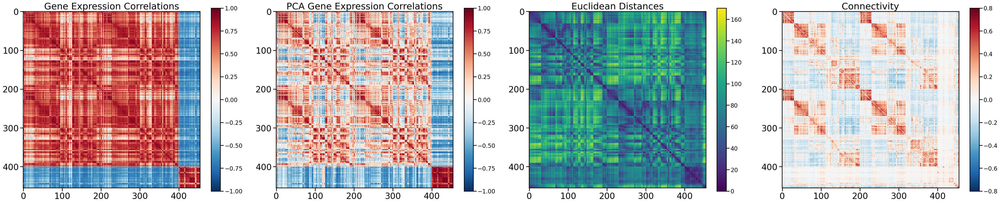

In [107]:
spins_df = generate_null_spins(n_rotations=1000, seed=42, bin_size_mm=5, save_csv=True)

In [108]:
spins_df.sort_values('mean_error_rank', ascending=True, inplace=True)
spins_df.head(20)

,cortical_spins,subcortical_spins,cortical_cost,subcortical_cost,total_cost,mean_error_rank,total_cost_rank,SA_error_rank,poly_error_rank,standardized_SA_error,...,SA_lambda_PCA,SA_inf_PCA,poly_a1,poly_a2,poly_a3,poly_a4,poly_a1_PCA,poly_a2_PCA,poly_a3_PCA,poly_a4_PCA
417,"[1, 6, 4, 0, 2, 69, 12, 68, 5, 3, 10, 7, 15, 1...","[0, 33, 2, 29, 1, 5, 6, 7, 8, 3, 10, 11, 12, 1...",9868.096901,612.102793,10480.199694,4.333333,5.0,1.0,7.0,0.607846,...,52.261598,-0.265963,1.096968,-0.028375,0.000318,-1.088029e-06,1.049116,-0.032066,0.000341,-1.219766e-06
177,"[2, 68, 5, 8, 14, 18, 0, 26, 11, 4, 17, 23, 1,...","[4, 0, 42, 43, 5, 1, 8, 6, 13, 47, 7, 2, 9, 12...",11961.078298,1447.026042,13408.104341,26.000000,40.0,32.0,6.0,1.553003,...,37.750859,-0.137079,1.069441,-0.029168,0.000342,-1.204074e-06,1.034368,-0.033173,0.000359,-1.265968e-06
591,"[195, 196, 111, 108, 53, 84, 197, 83, 54, 107,...","[53, 54, 52, 48, 55, 50, 11, 5, 13, 49, 0, 51,...",11073.534665,2344.012760,13417.547425,29.666667,42.0,8.0,39.0,1.155805,...,32.650183,-0.071122,1.045532,-0.026877,0.000305,-1.053135e-06,0.965263,-0.027858,0.000271,-8.718337e-07
490,"[66, 145, 110, 197, 108, 67, 106, 53, 54, 107,...","[53, 54, 52, 49, 55, 47, 11, 13, 12, 50, 0, 46...",10607.169638,2515.147689,13122.317327,30.000000,33.0,24.0,33.0,1.403816,...,29.221955,-0.032078,1.052451,-0.027066,0.000305,-1.044906e-06,0.975886,-0.028211,0.000270,-8.346156e-07
552,"[175, 116, 136, 117, 166, 134, 115, 179, 165, ...","[6, 53, 43, 55, 42, 32, 13, 46, 34, 28, 49, 47...",11242.055020,2886.961480,14129.016500,36.666667,66.0,29.0,15.0,1.490634,...,36.849929,-0.125471,1.056644,-0.029897,0.000365,-1.327223e-06,1.013769,-0.033516,0.000375,-1.347433e-06
604,"[167, 117, 170, 115, 134, 135, 125, 138, 169, ...","[7, 53, 28, 55, 51, 6, 13, 34, 12, 42, 48, 47,...",10864.599299,2806.813217,13671.412516,39.666667,50.0,55.0,14.0,1.954915,...,35.694274,-0.110154,1.035762,-0.028654,0.000346,-1.237894e-06,1.004139,-0.033194,0.000372,-1.331566e-06
513,"[68, 122, 2, 0, 1, 7, 124, 69, 5, 125, 4, 8, 6...","[0, 1, 2, 31, 4, 5, 8, 13, 6, 9, 7, 11, 12, 29...",10790.842995,402.839603,11193.682598,48.000000,9.0,134.0,1.0,2.997028,...,36.161657,-0.101488,1.110649,-0.030320,0.000347,-1.174430e-06,1.055275,-0.032979,0.000346,-1.180985e-06
627,"[15, 19, 17, 25, 21, 4, 191, 13, 20, 190, 24, ...","[9, 1, 2, 48, 5, 11, 10, 32, 30, 12, 31, 13, 7...",12350.492050,845.049840,13195.541890,49.666667,34.0,56.0,59.0,1.983217,...,49.191434,-0.236733,1.051466,-0.026055,0.000284,-9.386893e-07,0.999594,-0.029631,0.000308,-1.091490e-06
588,"[11, 10, 22, 9, 18, 8, 4, 14, 5, 15, 24, 17, 3...","[9, 0, 49, 43, 11, 2, 8, 6, 5, 47, 7, 42, 55, ...",12340.410452,1556.261787,13896.672239,57.333333,57.0,3.0,112.0,0.998438,...,47.503070,-0.232420,1.019346,-0.024476,0.000268,-9.099526e-07,0.985025,-0.029148,0.000302,-1.065657e-06
178,"[20, 1, 17, 10, 190, 29, 9, 28, 191, 21, 15, 1...","[43, 49, 53, 51, 55, 4, 13, 12, 8, 54, 29, 2, ...",12018.468107,2019.475078,14037.943185,58.666667,63.0,91.0,22.0,2.412762,...,37.964487,-0.142498,1.043590,-0.027613,0.000318,-1.094800e-06,1.060691,-0.036475,0.000418,-1.523929e-06


In [111]:
spins_df.iloc[:, 4:]

,total_cost,mean_error_rank,total_cost_rank,SA_error_rank,poly_error_rank,standardized_SA_error,standardized_poly_error,standardized_SA_PCA_error,standardized_poly_PCA_error,SA_lambda,...,SA_lambda_PCA,SA_inf_PCA,poly_a1,poly_a2,poly_a3,poly_a4,poly_a1_PCA,poly_a2_PCA,poly_a3_PCA,poly_a4_PCA
417,10480.199694,4.333333,5.0,1.0,7.0,0.607846,2.752689,0.310696,2.528990,26.171549,...,52.261598,-0.265963,1.096968,-0.028375,0.000318,-1.088029e-06,1.049116,-0.032066,0.000341,-1.219766e-06
177,13408.104341,26.000000,40.0,32.0,6.0,1.553003,2.483264,3.953644,2.954616,23.110388,...,37.750859,-0.137079,1.069441,-0.029168,0.000342,-1.204074e-06,1.034368,-0.033173,0.000359,-1.265968e-06
591,13417.547425,29.666667,42.0,8.0,39.0,1.155805,4.606737,5.709201,6.968627,24.365852,...,32.650183,-0.071122,1.045532,-0.026877,0.000305,-1.053135e-06,0.965263,-0.027858,0.000271,-8.718337e-07
490,13122.317327,30.000000,33.0,24.0,33.0,1.403816,4.451341,6.817713,6.830485,23.789562,...,29.221955,-0.032078,1.052451,-0.027066,0.000305,-1.044906e-06,0.975886,-0.028211,0.000270,-8.346156e-07
552,14129.016500,36.666667,66.0,29.0,15.0,1.490634,3.497339,4.263150,3.780296,23.860139,...,36.849929,-0.125471,1.056644,-0.029897,0.000365,-1.327223e-06,1.013769,-0.033516,0.000375,-1.347433e-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
645,17916.401961,920.666667,933.0,996.0,833.0,8.479342,15.479037,10.849420,12.734169,12.992174,...,17.498655,0.119277,0.883798,-0.019038,0.000178,-4.233107e-07,0.869320,-0.023769,0.000193,-4.089669e-07
185,18217.469426,923.000000,970.0,971.0,828.0,8.111190,15.437717,10.249325,12.097121,13.506574,...,18.789104,0.091047,0.875543,-0.018912,0.000182,-4.590073e-07,0.850908,-0.024177,0.000215,-5.542322e-07
717,17599.901026,932.666667,876.0,939.0,983.0,7.814361,19.293562,10.235419,16.138441,13.773244,...,19.137892,0.094394,0.815003,-0.015453,0.000136,-2.997833e-07,0.785630,-0.020078,0.000157,-3.295723e-07
120,18709.832032,939.333333,991.0,997.0,830.0,8.516369,15.462473,10.804235,12.005583,12.917080,...,17.438770,0.115181,0.880838,-0.019064,0.000180,-4.307581e-07,0.872587,-0.024509,0.000207,-4.761058e-07


#### Plot some CGE vs distance decay curves

In [112]:
spins_df = pd.read_csv('./data/enigma/1000_null_spins.csv')

In [113]:
spins_df.dtypes

cortical_spins                  object
subcortical_spins               object
cortical_cost                  float64
subcortical_cost               float64
total_cost                     float64
mean_error_rank                float64
total_cost_rank                float64
SA_error_rank                  float64
poly_error_rank                float64
standardized_SA_error          float64
standardized_poly_error        float64
standardized_SA_PCA_error      float64
standardized_poly_PCA_error    float64
SA_lambda                      float64
SA_inf                         float64
SA_lambda_PCA                  float64
SA_inf_PCA                     float64
poly_a1                        float64
poly_a2                        float64
poly_a3                        float64
poly_a4                        float64
poly_a1_PCA                    float64
poly_a2_PCA                    float64
poly_a3_PCA                    float64
poly_a4_PCA                    float64
dtype: object

In [114]:
# Sort spins_df by standardized_SA_error in ascending order
sort_spins = 'mean_error_rank'
spins_df = spins_df.sort_values(sort_spins, ascending=True)

# Get list of indices to use for each null spin
cortical_spins_list = spins_df['cortical_spins'].tolist()
print(cortical_spins_list[0])
cortical_spins_list = [eval(x) for x in cortical_spins_list]
cortical_spin_indices = np.array(cortical_spins_list).reshape(1000, 400)
print(cortical_spin_indices.shape)

# Get list of indices to use for each null spin for subcortical regions
subcortical_spins_list = spins_df['subcortical_spins'].tolist()
subcortical_spins_list = [eval(x) for x in subcortical_spins_list]
subcortical_spin_indices = np.array(subcortical_spins_list).reshape(1000, 56)
print(subcortical_spin_indices.shape)

[1, 6, 4, 0, 2, 69, 12, 68, 5, 3, 10, 7, 15, 16, 11, 9, 132, 8, 23, 189, 17, 20, 71, 13, 14, 24, 18, 22, 26, 28, 72, 35, 99, 101, 33, 34, 32, 167, 38, 89, 40, 39, 90, 42, 43, 93, 47, 44, 197, 50, 75, 131, 52, 110, 53, 54, 56, 59, 51, 78, 85, 65, 62, 67, 111, 58, 66, 84, 121, 150, 153, 70, 160, 73, 27, 45, 164, 79, 130, 57, 126, 74, 81, 77, 83, 49, 64, 60, 88, 139, 140, 91, 36, 41, 94, 154, 98, 169, 166, 100, 174, 102, 138, 103, 104, 183, 48, 146, 108, 55, 199, 82, 61, 116, 113, 168, 173, 172, 165, 124, 120, 142, 122, 96, 114, 125, 163, 127, 92, 161, 129, 76, 118, 175, 134, 181, 179, 170, 105, 141, 184, 180, 133, 30, 80, 145, 196, 109, 148, 151, 119, 123, 97, 149, 155, 152, 31, 156, 157, 158, 159, 95, 37, 128, 162, 115, 117, 192, 19, 171, 137, 136, 176, 106, 135, 177, 107, 182, 178, 186, 86, 185, 147, 187, 46, 87, 112, 188, 63, 21, 25, 190, 191, 143, 29, 193, 194, 195, 198, 144, 200, 206, 202, 203, 201, 204, 213, 207, 270, 215, 205, 392, 212, 216, 214, 338, 219, 209, 210, 218, 217, 221,

Number of components for 95% variance PCA: 27


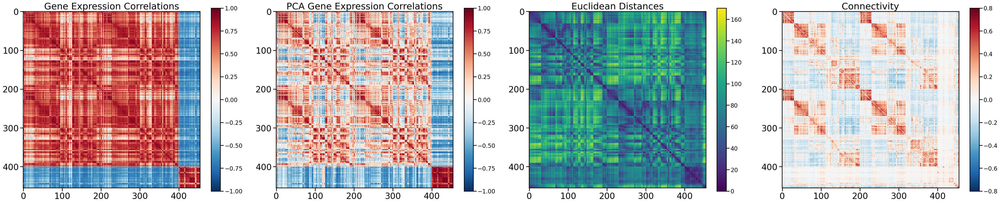

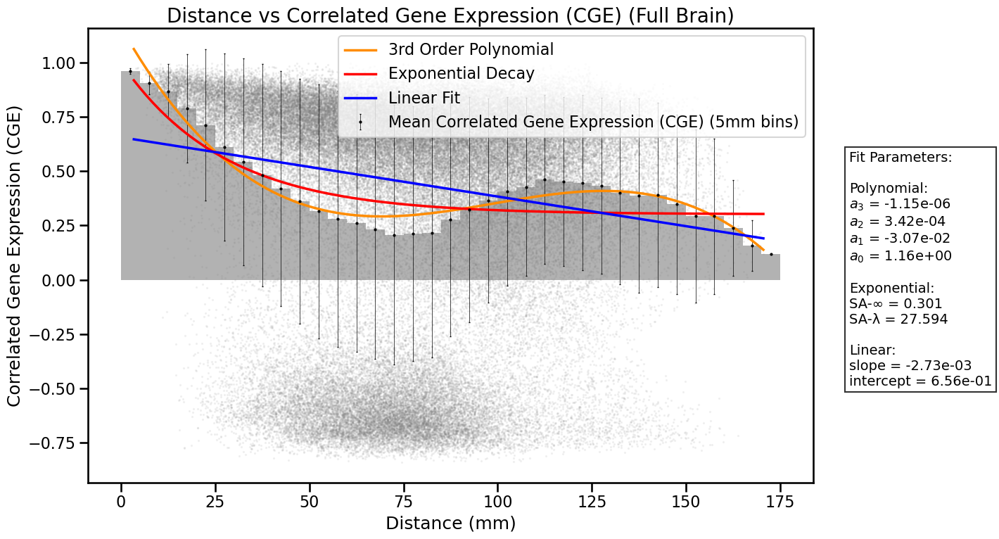

In [115]:
X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix = load_and_plot_data(parcellation='S400', hemisphere='both', omit_subcortical=False, 
                      sort_genes='expression', impute_strategy='mirror_interpolate', null_model='none', fontsize=26)

features, features_cortex, features_subcortex = subset_brain_data(X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix)

plot_distance_fits(features, 'CGE', 5, 'Full Brain')

In [116]:
genes_data, valid_genes = load_transcriptome(parcellation='S400', 
                                             gene_list='0.2',
                                             run_PCA=False, 
                                             omit_subcortical=False, 
                                             hemisphere='both', 
                                             impute_strategy='mirror_interpolate', 
                                             sort_genes='expression', 
                                             return_valid_genes=True, null_model='none', random_seed=42)

genes_data_PCA = load_transcriptome(parcellation='S400', 
                                             gene_list='0.2',
                                             run_PCA=True, 
                                             omit_subcortical=False, 
                                             hemisphere='both', 
                                             impute_strategy='mirror_interpolate', 
                                             sort_genes='expression', 
                                             return_valid_genes=False, null_model='none', random_seed=42)

all_region_coords = load_coords(parcellation='S400', omit_subcortical=False)

num_cortical_regions = (genes_data.shape[0] // 100) * 100
cortical_genes_data = genes_data[:num_cortical_regions]
cortical_genes_data_PCA = genes_data_PCA[:num_cortical_regions]
subcortical_genes_data = genes_data[num_cortical_regions:]
subcortical_genes_data_PCA = genes_data_PCA[num_cortical_regions:]
subcortical_coords = all_region_coords[num_cortical_regions:]
x_coords = subcortical_coords[:, 0]
hemi_subcort = np.zeros_like(x_coords) # create mask for subcortical hemisphere
hemi_subcort[x_coords > 0] = 1


valid genes ['CRNDE', 'ECEL1', 'CHRNA3', 'RSPO4', 'TTR', 'RGS8', 'CA12', 'GINS3', 'KLHL13', 'S100PBP', 'PARD3B', 'PDE3A', 'SIX3', 'SCIN', 'NHSL1', 'BTN2A2', 'PIRT', 'RAB2B', 'SMIM30', 'DRD2', 'LONRF3', 'CYB5R3', 'SLITRK6', 'ELP4', 'HEYL', 'PKNOX1', 'GPRIN2', 'LHX8', 'MEGF11', 'C10orf105', 'AUTS2', 'PDIA3', 'PDIA3P1', 'CPNE3', 'TMEM255A', 'TMEM215', 'CYP7B1', 'IL13RA2', 'GPR75', 'TEAD1', 'KCNE5', 'PDLIM5', 'STAT1', 'C6orf118', 'CYLD', 'BAG3', 'TTPA', 'PINLYP', 'PCDH15', 'PREX2', 'PLXDC2', 'RASL12', 'DERL1', 'SCN7A', 'ARHGAP36', 'DNAJC12', 'AKIRIN2', 'ACVR1', 'ENKUR', 'NPL', 'FLVCR1', 'SAMD11', 'DNAH9', 'ADIPOR1', 'COL8A2', 'MAP3K1', 'LOC100233156', 'ADARB2-AS1', 'PFKFB3', 'SDC2', 'DAB2', 'CASC2', 'RGS22', 'PHKA1', 'HEY2', 'CENPVL3', 'PTGER3', 'CCDC85C', 'YBX3', 'PRSS35', 'VANGL1', 'PLXNA3', 'GLUD1', 'SSR1', 'MLF1', 'FAM210B', 'SERPINB1', 'WDR1', 'CFLAR', 'SZRD1', 'DAPL1', 'SPATA18', 'STK33', 'CFAP61', 'MAML2', 'DIRC2', 'ZNF516', 'MINK1', 'FAM111A', 'LINC01485', 'SCN9A', 'LINC00886', 'CX

In [117]:
# Best spin
cortical_spin_indices_best = cortical_spin_indices[0, :]
subcortical_spin_indices_best = subcortical_spin_indices[0, :]

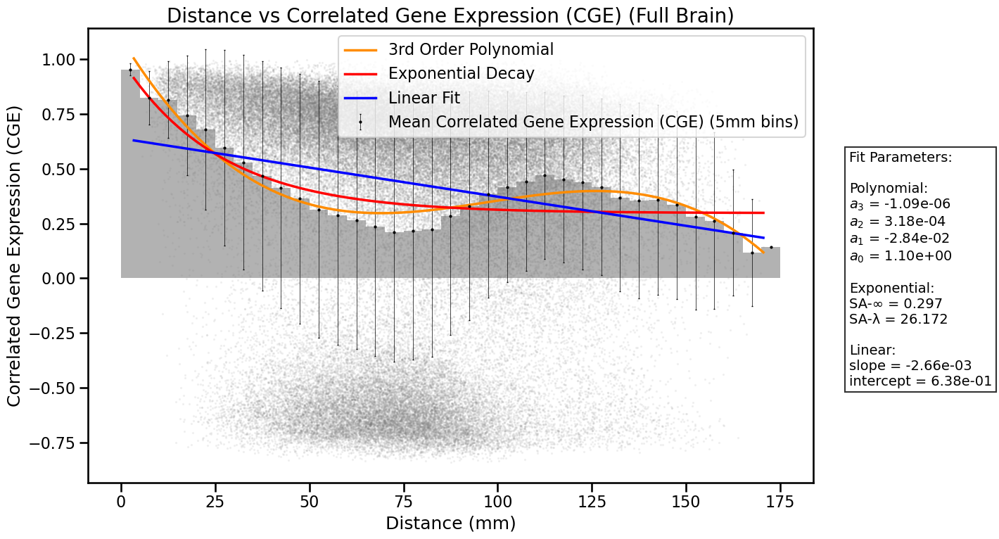

In [118]:
cortical_genes_data = cortical_genes_data 
subcortical_genes_data = subcortical_genes_data
cortical_genes_data_PCA = cortical_genes_data_PCA
subcortical_genes_data_PCA = subcortical_genes_data_PCA
coords = all_region_coords

cortical_spun_genes_data = cortical_genes_data[:][cortical_spin_indices_best]
subcortical_spun_genes_data = subcortical_genes_data[:][subcortical_spin_indices_best]
spun_genes_data = np.vstack([cortical_spun_genes_data, subcortical_spun_genes_data])
X_corr, CGE_vec, dist_matrix, dist_vec = load_features(spun_genes_data, all_region_coords)

features = {
    'distances': dist_vec,
    'CGE': CGE_vec
}

plot_distance_fits(features, 'CGE', bin_size_mm=5)


In [119]:
# Worst spin
cortical_spin_indices_worst = cortical_spin_indices[-1, :]
subcortical_spin_indices_worst = subcortical_spin_indices[-1, :]

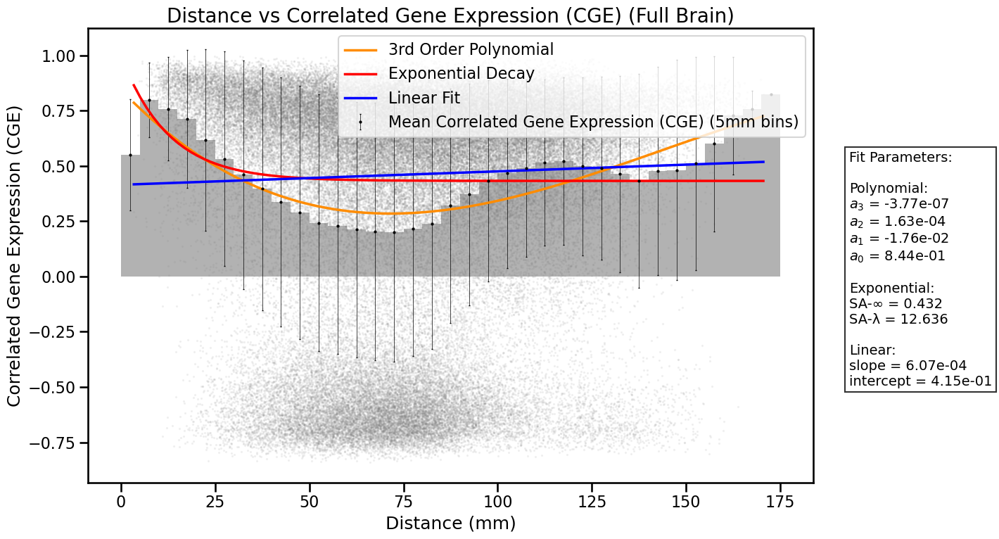

In [120]:
cortical_spun_genes_data = cortical_genes_data[:][cortical_spin_indices_worst]
subcortical_spun_genes_data = subcortical_genes_data[:][subcortical_spin_indices_worst]
spun_genes_data = np.vstack([cortical_spun_genes_data, subcortical_spun_genes_data])
X_corr, CGE_vec, dist_matrix, dist_vec = load_features(spun_genes_data, all_region_coords)

features = {
    'distances': dist_vec,
    'CGE': CGE_vec
}

plot_distance_fits(features, 'CGE', bin_size_mm=5)


In [121]:
np.random.seed(1)  # Set seed for reproducibility

# Retain hemisphere and subcortical random
cortex_lh_rh_mapping = dict(zip(cortical_spin_indices_best[:200], cortical_spin_indices_best[200:]))
lh_perm = np.random.permutation(np.arange(200))  # Generate one permutation
rh_perm = np.array([cortex_lh_rh_mapping[x] for x in lh_perm])  # Use mapping for RH indices
cortical_spin_indices_hemi_random = np.concatenate([lh_perm, rh_perm])
subcortical_spin_indices_hemi_random = np.random.permutation(np.arange(56)) 

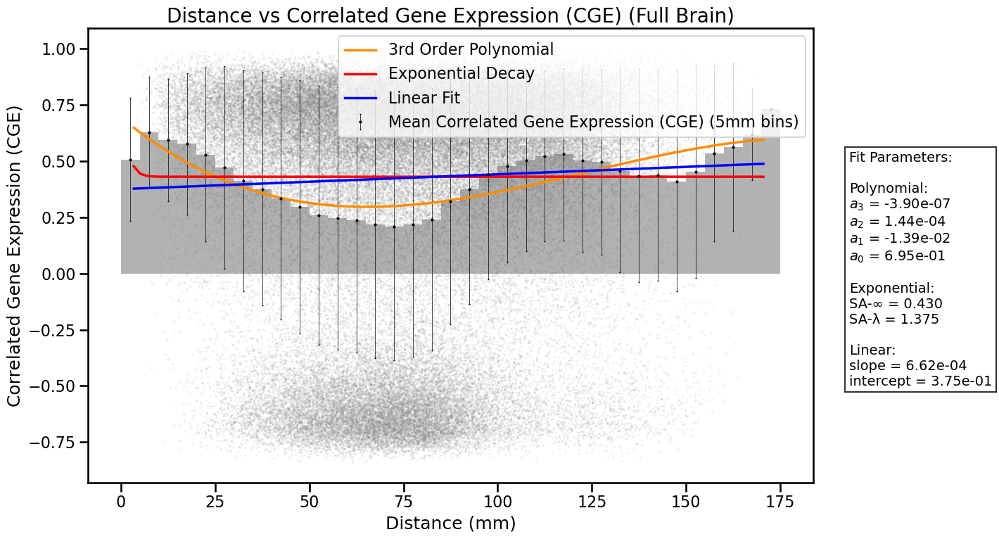

In [122]:
cortical_spun_genes_data = cortical_genes_data[:][cortical_spin_indices_hemi_random]
subcortical_spun_genes_data = subcortical_genes_data[:][subcortical_spin_indices_hemi_random]
spun_genes_data = np.vstack([cortical_spun_genes_data, subcortical_spun_genes_data])
X_corr, CGE_vec, dist_matrix, dist_vec = load_features(spun_genes_data, all_region_coords)

features = {
    'distances': dist_vec,
    'CGE': CGE_vec
}

plot_distance_fits(features, 'CGE', bin_size_mm=5)


#### True random

In [123]:
# true random
spin_indices_random = np.random.permutation(np.arange(456))

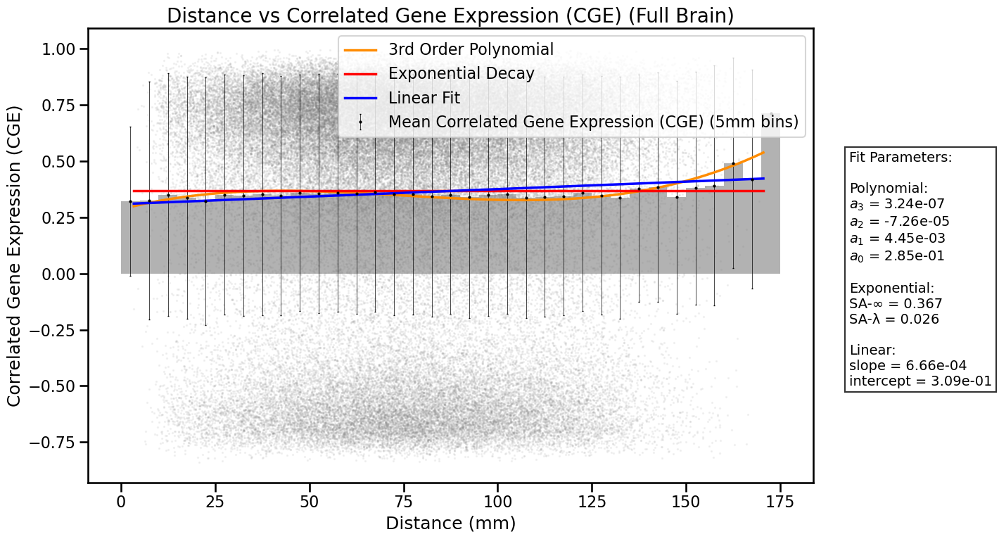

In [124]:
spun_genes_data = genes_data[:][spin_indices_random]
X_corr, CGE_vec, dist_matrix, dist_vec = load_features(spun_genes_data, all_region_coords)

features = {
    'distances': dist_vec,
    'CGE': CGE_vec
}

plot_distance_fits(features, 'CGE', bin_size_mm=5)
